In [50]:
import mysql.connector
import pandas as pd
import numpy as np

In [51]:
from mysql.connector import connect
from getpass import getpass

In [52]:
db = connect(
host = 'localhost',
user = 'root',
passwd = getpass('Enter password:'),
database = 'sakila')

Enter password:········


# Read the data into a Pandas dataframe

In [78]:
cursor = db.cursor()
query = '''SELECT 
    f.film_id, f.title, f.rental_rate, f.rental_duration, f.rating, r.rental_date
FROM
    sakila.film f
        JOIN
    sakila.inventory i  ON f.film_id = i.film_id
        JOIN
    sakila.rental r ON i.inventory_id = r.inventory_id;'''
cursor.execute(query)


In [54]:
database=pd.DataFrame(cursor.fetchall())
database

,0,1,2,3,4,5
0,1,ACADEMY DINOSAUR,0.99,6,PG,2005-07-08 19:03:15
1,1,ACADEMY DINOSAUR,0.99,6,PG,2005-08-02 20:13:10
2,1,ACADEMY DINOSAUR,0.99,6,PG,2005-08-21 21:27:43
3,1,ACADEMY DINOSAUR,0.99,6,PG,2005-05-30 20:21:07
4,1,ACADEMY DINOSAUR,0.99,6,PG,2005-06-17 20:24:00
5,1,ACADEMY DINOSAUR,0.99,6,PG,2005-07-07 10:41:31
6,1,ACADEMY DINOSAUR,0.99,6,PG,2005-07-30 22:02:34
7,1,ACADEMY DINOSAUR,0.99,6,PG,2005-08-23 01:01:01
8,1,ACADEMY DINOSAUR,0.99,6,PG,2005-07-31 21:36:07
9,1,ACADEMY DINOSAUR,0.99,6,PG,2005-08-22 23:56:37


In [55]:
query = '''SELECT 
    f.film_id, f.title, c.name as category_name, f.rental_rate, f.rental_duration, f.rating, r.rental_date
FROM
    sakila.film f
        JOIN
    sakila.film_category fc  ON f.film_id = fc.film_id
        JOIN
    sakila.category c  ON fc.category_id = c.category_id
        JOIN
    sakila.inventory i  ON f.film_id = i.film_id
        JOIN
    sakila.rental r ON i.inventory_id = r.inventory_id;'''
cursor.execute(query)


In [56]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [57]:
database=pd.DataFrame(cursor.fetchall())
database

,0,1,2,3,4,5,6
0,19,AMADEUS HOLY,Action,0.99,6,PG,2005-08-02 01:16:59
1,19,AMADEUS HOLY,Action,0.99,6,PG,2005-08-18 04:26:54
2,19,AMADEUS HOLY,Action,0.99,6,PG,2005-06-20 20:35:28
3,19,AMADEUS HOLY,Action,0.99,6,PG,2005-07-09 05:01:58
4,19,AMADEUS HOLY,Action,0.99,6,PG,2005-07-30 08:02:39
5,19,AMADEUS HOLY,Action,0.99,6,PG,2005-08-21 17:51:06
6,19,AMADEUS HOLY,Action,0.99,6,PG,2005-05-28 12:08:37
7,19,AMADEUS HOLY,Action,0.99,6,PG,2005-06-20 00:08:38
8,19,AMADEUS HOLY,Action,0.99,6,PG,2005-07-11 02:37:51
9,19,AMADEUS HOLY,Action,0.99,6,PG,2005-07-28 07:21:55


# Analyze extracted features and transform them. You may need to encode some categorical variables, or scale numerical variables.


In [58]:
database.dtypes

0             int64
1            object
2            object
3            object
4             int64
5            object
6    datetime64[ns]
dtype: object

In [83]:
database.isna().sum()

0                    0
title                0
rental_rate          0
rental_duration\t    0
rating               0
rental_date          0
rental_date          0
dtype: int64

In [66]:
database.rename(columns={ 1: 'title', 2: 'category', 3: 'rental_rate	', 4: 'rental_duration', 5: 'rating', 6: 'rental_date'}, inplace=True)

In [67]:
database

,0,title,rental_rate,rental_duration\t,rating,rental_date,rental_date
0,19,amadeus holy,Action,0.99,6,PG,2005-08-02 01:16:59
1,19,amadeus holy,Action,0.99,6,PG,2005-08-18 04:26:54
2,19,amadeus holy,Action,0.99,6,PG,2005-06-20 20:35:28
3,19,amadeus holy,Action,0.99,6,PG,2005-07-09 05:01:58
4,19,amadeus holy,Action,0.99,6,PG,2005-07-30 08:02:39
5,19,amadeus holy,Action,0.99,6,PG,2005-08-21 17:51:06
6,19,amadeus holy,Action,0.99,6,PG,2005-05-28 12:08:37
7,19,amadeus holy,Action,0.99,6,PG,2005-06-20 00:08:38
8,19,amadeus holy,Action,0.99,6,PG,2005-07-11 02:37:51
9,19,amadeus holy,Action,0.99,6,PG,2005-07-28 07:21:55


In [61]:
def title_corr(n):
    n = n.lower()
    return n
database['title'] = database['title'].apply(title_corr)
database['title']


0                       amadeus holy
1                       amadeus holy
2                       amadeus holy
3                       amadeus holy
4                       amadeus holy
5                       amadeus holy
6                       amadeus holy
7                       amadeus holy
8                       amadeus holy
9                       amadeus holy
10                      amadeus holy
11                      amadeus holy
12                      amadeus holy
13                      amadeus holy
14                      amadeus holy
15                      amadeus holy
16                      amadeus holy
17                      amadeus holy
18                      amadeus holy
19                      amadeus holy
20                      amadeus holy
21                   american circus
22                   american circus
23                   american circus
24                   american circus
25                   american circus
26                   american circus
2

In [62]:
database['rating'].value_counts()

3    3412
6    3393
4    3251
5    3165
7    2824
Name: rating, dtype: int64

In [63]:
def rental_duration_trans(i):
    i = str(i)
    return i
database['rental_duration\t']= database['rental_duration\t'].apply(rental_duration_trans)
database['rental_duration\t']

0        0.99
1        0.99
2        0.99
3        0.99
4        0.99
5        0.99
6        0.99
7        0.99
8        0.99
9        0.99
10       0.99
11       0.99
12       0.99
13       0.99
14       0.99
15       0.99
16       0.99
17       0.99
18       0.99
19       0.99
20       0.99
21       4.99
22       4.99
23       4.99
24       4.99
25       4.99
26       4.99
27       4.99
28       4.99
29       4.99
30       4.99
31       4.99
32       4.99
33       4.99
34       4.99
35       4.99
36       4.99
37       4.99
38       4.99
39       4.99
40       4.99
41       4.99
42       4.99
43       2.99
44       2.99
45       2.99
46       2.99
47       2.99
48       2.99
49       2.99
50       2.99
51       2.99
52       2.99
53       2.99
54       2.99
55       2.99
56       2.99
57       2.99
58       2.99
59       2.99
60       2.99
61       2.99
62       2.99
63       2.99
64       2.99
65       2.99
66       2.99
67       2.99
68       2.99
69       2.99
70       2.99
71    

In [79]:
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import seaborn as sns

<AxesSubplot:>

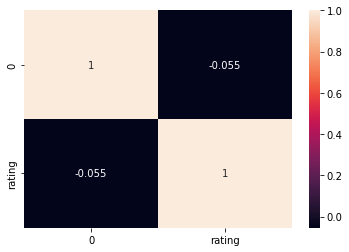

In [65]:
# checking correlation among features
correlations_matrix= database.corr()
sns.heatmap(correlations_matrix, annot=True)

In [85]:
dummies = pd.get_dummies(database['rental_date']).rename(columns=lambda x: 'rental_date' + str(x))
database = pd.concat([database, dummies], axis=1)



In [87]:
database['month']=pd.DatetimeIndex(database['rental_date']).month
database['year']=pd.DatetimeIndex(database['rental_date']).year


ParserError: Unknown string format: PG

In [89]:
# distribution of the numerical columns
numerical = database.select_dtypes(include = np.number)
numerical_columns = database.select_dtypes(exclude=['object']).columns.tolist()
numerical_columns

[0,
 'rating',
 'rental_date',
 'rental_daterental_date',
 'rental_daterental_date_G',
 'rental_daterental_date_NC-17',
 'rental_daterental_date_PG',
 'rental_daterental_date_PG-13',
 'rental_daterental_date_R']

In [90]:

# Dummifing categorical columns
cat = database.select_dtypes(include = np.object)
categorical = pd.get_dummies(cat, columns=['title', 'category_name', 'rental_duration', 'rating'], drop_first=True)
categorical.head()

C:\Users\NIDHAL\AppData\Local\Temp\ipykernel_19316\3027038080.py:2: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cat = database.select_dtypes(include = np.object)


KeyError: "['category_name', 'rental_duration', 'rating'] not in index"